In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
    
%matplotlib inline

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import pandas as pd 
import numpy as np

import matplotlib.pyplot as plt

## Load Data

In [2]:
server = pd.read_csv('./server_utilization.csv')

## General Visualization of Utilization Patterns

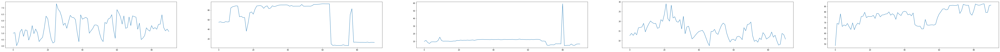

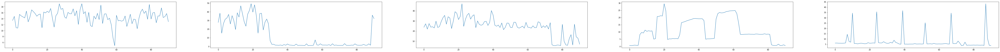

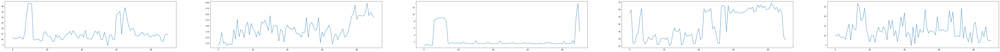

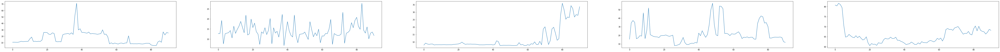

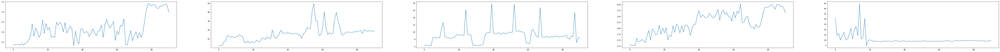

...

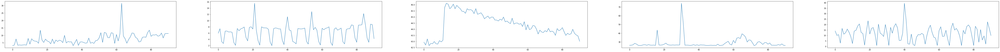

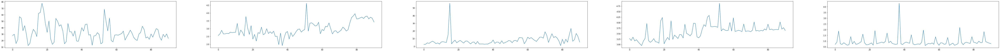

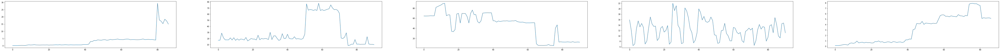

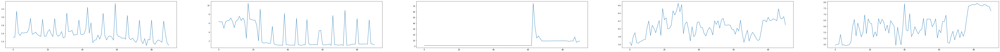

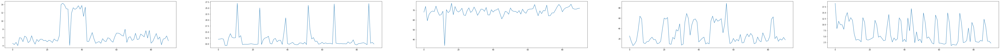

In [3]:
group = server.groupby('asset_id')

ids = list(group.groups.keys())

# Breaking up each figure into a row for performance reasons
col, row = 5, int(len(ids)/5)
i = 0
for r in range(row):
    _ = plt.figure(figsize=(100,300))
    for c in range(col):
        y = (group.get_group(ids[i])['max_util']).tolist()
        _ = plt.subplot(row,col,i+1)
        _ = plt.plot(y)
        i += 1
    plt.show()

In [4]:
df_server = server[['max_util']]
df_server['hashed_id'] = server['asset_id'].apply(hash)
server_group = df_server.groupby('max_util').apply(lambda server: server.reset_index(drop=True))

In [5]:
from sklearn.preprocessing import scale
x = server_group
x[x.columns] = scale(x[x.columns])
x.head()

max_util  hashed_id
max_util                       
0.000    0 -0.917376   1.523969
         1 -0.917376  -0.897535
         2 -0.917376   1.455108
         3 -0.917376   1.455108
0.078    0 -0.912434  -0.576968

In [6]:
from sklearn.cluster import KMeans
model = KMeans(n_clusters=5, random_state=1).fit(x)
kMeans_labels = model.labels_

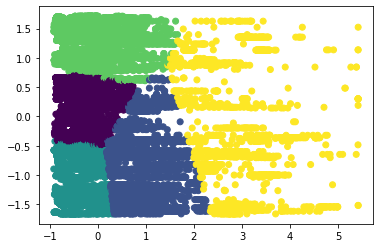

In [7]:
_ = plt.scatter(x['max_util'], x['hashed_id'],c=kMeans_labels)

In [8]:
from sklearn.metrics import silhouette_score

silhouette_score(x, kMeans_labels)

0.40955311409282485

In [9]:
# Function for k-means clustering

def cluster_kMeans(x, k):
    model = KMeans(n_clusters=k, random_state=1)
    model.fit(x)
    kMeans_labels = model.labels_
    kMeans_sil_score = silhouette_score(x, kMeans_labels)
    return (kMeans_labels, kMeans_sil_score)

In [10]:
# Iterate over differenv values of ka to determine the one giving the highest silhouette score

for k in range(2,16):
    kMeans_labels, kMeans_sil_score = cluster_kMeans(x,k)
    print('k: ', k, '\t\t', 'Silhoutte score:', kMeans_sil_score)

k:  2 		 Silhoutte score: 0.4058340489712253
k:  3 		 Silhoutte score: 0.4686208362174131
k:  4 		 Silhoutte score: 0.3904656520636
k:  5 		 Silhoutte score: 0.40955311409282485
k:  6 		 Silhoutte score: 0.425946554396183
k:  7 		 Silhoutte score: 0.4232950988853993
k:  8 		 Silhoutte score: 0.4018024419163039
k:  9 		 Silhoutte score: 0.4046687414148975
k:  10 		 Silhoutte score: 0.4068955618555945
k:  11 		 Silhoutte score: 0.40057808203398343
k:  12 		 Silhoutte score: 0.4157563134378393
k:  13 		 Silhoutte score: 0.40822014603116524
k:  14 		 Silhoutte score: 0.37850459617335874
k:  15 		 Silhoutte score: 0.4036871496688359


In [11]:
from sklearn.cluster import AgglomerativeClustering

h_model = AgglomerativeClustering(n_clusters=3)
h_model.fit(x)
hCluster_labels = h_model.labels_

silhouette_score(x, hCluster_labels)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
                        connectivity=None, distance_threshold=None,
                        linkage='ward', memory=None, n_clusters=3)

0.41566438009724777

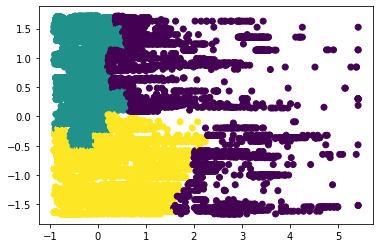

In [12]:
plt.scatter(x['max_util'], x['hashed_id'],c=hCluster_labels)

In [13]:
from sklearn.cluster import DBSCAN

db_model = DBSCAN(eps=0.5)
db_model.fit(x)
dbscan_labels = db_model.labels_

silhouette_score(x, dbscan_labels)

DBSCAN(algorithm='auto', eps=0.5, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=5, n_jobs=None, p=None)

0.6569024917186104

In [14]:
dbscan_clusters = len(set(dbscan_labels)) - (1 if -1 in dbscan_labels else 0)
dbscan_noise = list(dbscan_labels).count(-1)

print('Clusters: ', dbscan_clusters, '\t\t', 'Noise: ', dbscan_noise)

Clusters:  2 		 Noise:  0


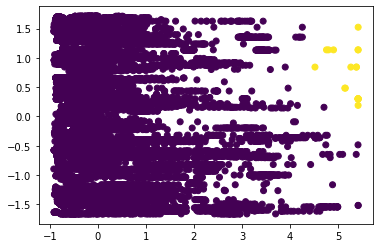

In [15]:
plt.scatter(x['max_util'], x['hashed_id'],c=dbscan_labels)

## Conclusions

From what has been observed, dbscan and hclustering doesnt really make sense in this case, however Kmeans shows some promising results with a k value of 3, 4 and 6 for clustering this set of data based off the CPU utilization patterns.

Upon futher investigation, it would appear that using 3 different groups is decent based off of the visual representation of the data. However, there are several flaws that need to be addressed with deeper analysis: the grouping appears to be based off of utlization and time, and not strictly shape. This means that patterns that might be similar in real world usage might be uncaught. i.e. low usage until day 3, a large spike, then low usage until the end vs low usage until day 6, a large spike, then low usage until the end. In the reality, these two patterns are similar in that they could represent a VM that was spun up for a specific task on a specific day, however the algorithm might not group them together as they are offset in the time domain.